#初期化

## install&import

In [1]:
from datetime import datetime
import pytz
japan_tz = pytz.timezone('Asia/Tokyo')
japan_time = datetime.now(japan_tz)
print("東京時間:", japan_time.strftime("%Y-%m-%d %H:%M:%S"))

東京時間: 2025-08-01 17:46:23


In [2]:
from google.colab import drive
drive.mount('/content/drive')
cfg_path = "/content/drive/MyDrive/ViZDoom_Gymnasium5/deadly_corridor.cfg"
wad_path = "/content/drive/MyDrive/ViZDoom_Gymnasium5/deadly_corridor.wad"
tensorboard_logs="/content/drive/MyDrive/ViZDoom_Gymnasium5/tensorboard_logs/"

Mounted at /content/drive


In [3]:
!pip install stable-baselines3[extra]
!pip install vizdoom gymnasium
#!pip install imageio imageio-ffmpeg

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 64.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 55.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 39.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 62.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 187.2/187.2 kB 13.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [4]:
from vizdoom import DoomGame, Mode, ScreenResolution, Button, GameVariable, gymnasium_wrapper
import gymnasium as gym
from gymnasium import Env, spaces
from gymnasium.spaces import Box, Dict
from gymnasium.wrappers import FlattenObservation

import numpy as np
import cv2
import shutil
import pandas as pd
import os
import glob
import re
import matplotlib.pyplot as plt
import time
import imageio
from IPython.display import Video
from google.colab.patches import cv2_imshow
from collections import deque
import random

from stable_baselines3 import PPO
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.callbacks import EvalCallback, BaseCallback
from stable_baselines3.common.env_util import make_vec_env
from stable_baselines3.common.vec_env import SubprocVecEnv, DummyVecEnv, VecTransposeImage
from stable_baselines3.common.utils import get_linear_fn
import torch
import torchvision.transforms as T


seed = 42
random.seed(seed)
np.random.seed(seed)




Gym has been unmaintained since 2022 and does not support NumPy 2.0 amongst other critical functionality.
Please upgrade to Gymnasium, the maintained drop-in replacement of Gym, or contact the authors of your software and request that they upgrade.
See the migration guide at https://gymnasium.farama.org/introduction/migration_guide/ for additional information.


##環境

###DoomCorridorHybridEnv ハイバード

In [5]:
class DoomCorridorHybridEnv(Env):
    def __init__(self, cfg_path, wad_path, frame_skip=4, stack_size=4, render_mode=None, resolution=ScreenResolution.RES_160X120,crop_image=True):
        super().__init__()
        self.cfg_path = cfg_path
        self.wad_path = wad_path
        self.frame_skip = frame_skip
        self.stack_size = stack_size
        self.render_mode = render_mode
        self.step_count = 0
        self.crop_image = crop_image

        self.actions = [

            [1, 0, 0, 0, 0, 0, 0],  # left
            [0, 1, 0, 0, 0, 0, 0],  # right
            [0, 0, 1, 0, 0, 0, 0],  # attack
            [0, 0, 0, 1, 0, 0, 0],  # forward
            #[0, 0, 1, 1, 0, 0, 0],  # forward + attack
            [0, 0, 0, 0, 1, 0, 0],  # back
            [0, 0, 0, 0, 0, 1, 0],  # turn_left
            [0, 0, 0, 0, 0, 0, 1],  # turn_right

        ]

        self.game = DoomGame()
        self.game.load_config(cfg_path)
        self.game.set_doom_scenario_path(wad_path)
        self.game.set_window_visible(False)
        self.game.set_mode(Mode.PLAYER)
        self.game.set_screen_resolution(resolution)
        self.game.init()

        self.state_stack = deque(maxlen=stack_size)

        self.observation_space = Dict({
            "image": Box(low=0, high=255, shape=(stack_size, 84, 84), dtype=np.uint8),
            "health": Box(0.0, 1.0, (1,), dtype=np.float32),
            "position_x": Box(0.0, 1.0, (1,), dtype=np.float32),
            "position_y": Box(0.0, 1.0, (1,), dtype=np.float32),
            "killcount": Box(0.0, 1.0, (1,), dtype=np.float32),
            #"attack_ready": Box(0.0, 1.0, (1,), dtype=np.float32),
            #"armor": Box(0.0, 1.0, (1,), dtype=np.float32),
            #"angle": Box(low=0.0, high=1.0, shape=(1,), dtype=np.float32),
            "angle_sin": Box(low=-1.0, high=1.0, shape=(1,), dtype=np.float32),
            "angle_cos": Box(low=-1.0, high=1.0, shape=(1,), dtype=np.float32),
            "ammo2": Box(low=0.0, high=1.0, shape=(1,), dtype=np.float32),
            "segment": Box(low=0.0, high=1.0, shape=(1,), dtype=np.float32),
            "segment_kills": Box(low=0.0, high=1.0, shape=(3,), dtype=np.float32),
        })

        self.action_space = spaces.Discrete(len(self.actions))

    def reset(self, *, seed=None, options=None):
        self.game.new_episode()
        self.step_count = 0

        obs = self._get_processed_obs()

        self.state_stack = deque([obs.copy() for _ in range(self.stack_size)], maxlen=self.stack_size)
        self.last_angle = self.game.get_game_variable(GameVariable.ANGLE)
        self.last_health = self.game.get_game_variable(GameVariable.HEALTH)
        self.last_position_x = self.game.get_game_variable(GameVariable.POSITION_X)
        self.last_position_y = self.game.get_game_variable(GameVariable.POSITION_Y)
        self.last_killcount = self.game.get_game_variable(GameVariable.KILLCOUNT)
        #self.last_attack_ready = self.game.get_game_variable(GameVariable.ATTACK_READY)
        self.last_armor = self.game.get_game_variable(GameVariable.ARMOR)
        self.last_ammo2 = self.game.get_game_variable(GameVariable.AMMO2)


        self.start_x = self.last_position_x
        self.max_x = self.start_x
        self.segment_kills = [0, 0, 0]
        self.current_segment = 0

        return self._build_obs(), {}

    def step(self, action_idx):

        self.step_count += 1
        action = self.actions[int(np.asarray(action_idx).item())]

        for _ in range(self.frame_skip):
            reward = self.game.make_action(action)
            if self.game.is_episode_finished():
                break

        obs = self._get_processed_obs()
        self.state_stack.append(obs.copy())


        terminated = self.game.is_episode_finished()
        #attack_ready = self.game.get_game_variable(GameVariable.ATTACK_READY)
        angle = self.game.get_game_variable(GameVariable.ANGLE)
        health = self.game.get_game_variable(GameVariable.HEALTH)
        position_x = self.game.get_game_variable(GameVariable.POSITION_X)
        position_y = self.game.get_game_variable(GameVariable.POSITION_Y)
        killcount = self.game.get_game_variable(GameVariable.KILLCOUNT)
        dead = self.game.get_game_variable(GameVariable.DEAD)
        armor = self.game.get_game_variable(GameVariable.ARMOR)
        ammo2 =  self.game.get_game_variable(GameVariable.AMMO2)

        shaped_reward = 0.0

        segment_bounds = [0, 250, 600, 1300]

        segment = 0
        for i in range(len(segment_bounds) - 1):
            if position_x >= segment_bounds[i] and position_x < segment_bounds[i + 1]:
                segment = i
                break

        kills_now = killcount - self.last_killcount
        if kills_now > 0:
            pre_kill = self.segment_kills[segment]
            new_kill = min(2 - pre_kill, kills_now)
            self.segment_kills[segment] = min(2, pre_kill + kills_now)
            shaped_reward += new_kill * 2.0

        if segment > self.current_segment:
            if self.segment_kills[self.current_segment] < 2:
                shaped_reward -= 2.0
            else:
                shaped_reward += 5.0
            self.current_segment = max(segment, self.current_segment)
        elif segment < self.current_segment:
            shaped_reward -= 2.0



        dx = position_x - self.last_position_x
        mdx = position_x - self.max_x
        if dx > 0:shaped_reward += dx * 0.01
        if dx < 0:shaped_reward += dx * 0.01


        """
        if position_x > self.max_x:
            shaped_reward += mdx * 0.01
            self.max_x = position_x
        """

        """
        if action_idx == 2:
            if attack_ready == 0:
                shaped_reward -= 1.0
            else:
                shaped_reward -= 0.1
        """

        if action_idx == 2:shaped_reward -= 0.1

        shaped_reward -= max(0, (self.last_health - health)*0.01)

        shaped_reward -= 0.01


        if health <= 0:
            shaped_reward -= 10.0

        if armor > 1:
            if all(k >= 2 for k in self.segment_kills):
                shaped_reward += 10.0
            else:
                shaped_reward += 5.0
            shaped_reward += health / 100


        self.last_health = health
        self.last_killcount = killcount
        self.last_position_x = position_x
        self.last_position_y = position_y
        #self.last_attack_ready = attack_ready
        self.last_angle = angle
        self.last_armor = armor
        self.last_ammo2 = ammo2


        return self._build_obs(), shaped_reward, terminated, False, {"health": health,"kills": killcount,"x": position_x,"reward": shaped_reward,"clear":armor}

    def _build_obs(self):
        angle_rad = np.deg2rad(self.last_angle)
        return {
            "image": np.stack(self.state_stack, axis=0),
            "health": np.array([min(self.last_health, 100.0) / 100.0], dtype=np.float32),
            "position_x": np.array([min(self.last_position_x, 1300.0) / 1300.0], dtype=np.float32),
            "position_y": np.array([np.clip((self.last_position_y + 400.0) / 800.0, 0.0, 1.0)], dtype=np.float32),
            "killcount": np.array([min(self.last_killcount, 8.0) / 8.0], dtype=np.float32),
            #"angle": np.array([self.last_angle / 360.0], dtype=np.float32),
            "angle_sin": np.array([np.sin(angle_rad)], dtype=np.float32),
            "angle_cos": np.array([np.cos(angle_rad)], dtype=np.float32),
            #"attack_ready": np.array([self.last_attack_ready], dtype=np.float32),
            #"armor": np.array([min(self.last_armor, 100.0) / 100.0], dtype=np.float32),
            "ammo2": np.array([min(self.last_ammo2, 50.0) / 50.0], dtype=np.float32),
            "segment": np.array([self.current_segment / 3.0], dtype=np.float32),
            "segment_kills": np.array([min(k, 4.0) / 4.0 for k in self.segment_kills], dtype=np.float32),


        }

    def _get_processed_obs(self):
        if self.game.is_episode_finished():
            return np.zeros((84, 84), dtype=np.uint8)

        screen = self.game.get_state().screen_buffer
        img = np.transpose(screen, (1, 2, 0))
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        resized = cv2.resize(gray, (84, 84), interpolation=cv2.INTER_AREA)
        return resized

    def render(self, mode="human"):
        if self.render_mode == "rgb_array" or mode == "rgb_array":
            if not self.game.is_episode_finished():
                frame = self.game.get_state().screen_buffer
                return np.transpose(frame, (1, 2, 0))
            else:
                return np.zeros((120, 160, 3), dtype=np.uint8)
        return None

    def close(self):
        self.game.close()


##Video output

In [9]:
def run_demo_and_save_video(model, video_path, fps=9, max_steps=3000):
    env = DoomCorridorHybridEnv(
        cfg_path=cfg_path,
        wad_path=wad_path,
        render_mode="rgb_array",
        resolution=ScreenResolution.RES_800X600,
    )

    obs, _ = env.reset()
    total_reward = 0.0
    frames = []
    first_frame = env.render(mode="rgb_array")
    print("obs[image] shape:", obs["image"].shape, "min:", obs["image"].min(), "max:", obs["image"].max())
    if first_frame is not None:
        frames.append(first_frame.copy())

    for _ in range(10):
        frame = env.render(mode="rgb_array")
        if frame is not None:
            frames.append(frame.copy())
        time.sleep(0.05)

    reward_log = []
    done = False
    step_count = 0

    while not done and step_count < max_steps:
        action, _ = model.predict({k: v[None] for k, v in obs.items()})
        obs, reward, done, _, info = env.step(action)
        total_reward += reward
        reward_log.append(reward)
        if info.get("clear", 0) > 1:
            print(f"Step {step_count}: CLEAR!")
        frame = env.render(mode="rgb_array")
        if frame is not None:
            frames.append(frame.copy())
        step_count += 1


    for _ in range(10):
        frame = env.render(mode="rgb_array")
        if frame is not None:
            frames.append(frame.copy())
        time.sleep(0.05)


    while len(frames) < 50:
        frames.append(frames[-1].copy())

    env.close()

    os.makedirs(os.path.dirname(video_path), exist_ok=True)

    #统一
    target_w, target_h = 800, 600
    for i in range(len(frames)):
        frames[i] = cv2.resize(frames[i], (target_w, target_h), interpolation=cv2.INTER_LINEAR)


    """
    # 保存视频：OpenCV
    writer = cv2.VideoWriter(
        video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (base_w, base_h)
    )
    for frame in frames:
        writer.write(cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))
    writer.release()
    print(f"cv2 mp4 saved: {video_path}")
    """

    imageio_path = video_path.replace(".mp4", "_imageio.mp4")
    imageio.mimsave(imageio_path, frames, fps=fps, macro_block_size=None)
    print(f"imageio mp4 saved: {imageio_path}")

    print(f"Total reward: {total_reward:.2f}")
    print("Reward log:", reward_log)
    return Video(imageio_path, embed=True)

##plot

In [7]:
def plot_eval_rewards(path):
    data = np.load(path)
    timesteps = data["timesteps"]
    rewards = data["results"]

    sort_idx = np.argsort(timesteps)
    timesteps_sorted = timesteps[sort_idx]
    rewards_sorted = rewards[sort_idx]

    if rewards_sorted.ndim == 2:
        rewards_mean = rewards_sorted.mean(axis=1)
    else:
        rewards_mean = rewards_sorted

    plt.figure(figsize=(8, 4))
    plt.plot(timesteps_sorted, rewards_mean, marker='o')
    plt.title("Mean Episode Reward During Training")
    plt.xlabel("Timesteps")
    plt.ylabel("Reward")
    plt.grid(True)
    plt.show()

##セット

In [8]:
def make_env():
    def _init():
        env = DoomCorridorHybridEnv(cfg_path, wad_path)
        env.reset(seed=seed)
        env = Monitor(env)

        return env
    return _init

def check_point(stepnum):
    model_path = "/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel"
    model.save(model_path)

    eval_npz = "/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz"
    eval_npz_backup = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations_{stepnum}.npz"
    model_zip = "/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip"
    model_zip_backup = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/Mymodel_{stepnum}.zip"
    shutil.copy(eval_npz, eval_npz_backup)
    shutil.copy(model_zip, model_zip_backup)
    return print(f"backup:{stepnum}")

class BestModelBackupCallback(BaseCallback):
    def __init__(self, step_fn, verbose=0):
        super().__init__(verbose)
        self.step_fn = step_fn

    def _on_step(self) -> bool:
        self.step_fn(self.model.num_timesteps)
        return True

num_envs = 1
train_env = DummyVecEnv([make_env()])
eval_env = DummyVecEnv([make_env()])

n_steps = 2048
n_step = n_steps

eval_callback = EvalCallback(
    eval_env,
    best_model_save_path="/content/drive/MyDrive/ViZDoom_Gymnasium5/",
    log_path="/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/",
    eval_freq=n_steps * 100,
    n_eval_episodes=10,
    #deterministic=True,
    render=False,
    callback_on_new_best=BestModelBackupCallback(check_point)
)

model = PPO(
    policy="MultiInputPolicy",
    env=train_env,
    #policy_kwargs=dict(net_arch=dict(pi=[256, 256], vf=[256, 256]),activation_fn=torch.nn.ReLU,normalize_images=False),
    learning_rate=2.5e-4,
    n_steps=n_steps,
    batch_size=64,
    n_epochs=4,
    gamma=0.99,
    gae_lambda=0.95,
    clip_range=0.1,
    ent_coef=0.01,#0
    vf_coef=0.5,
    max_grad_norm=0.5,
    #tensorboard_log=tensorboard_logs,
    verbose=1
)

#model = PPO("MultiInputPolicy", train_env, verbose=0)
print(model.policy)

Using cpu device
MultiInputActorCriticPolicy(
  (features_extractor): CombinedExtractor(
    (extractors): ModuleDict(
      (ammo2): Flatten(start_dim=1, end_dim=-1)
      (angle_cos): Flatten(start_dim=1, end_dim=-1)
      (angle_sin): Flatten(start_dim=1, end_dim=-1)
      (health): Flatten(start_dim=1, end_dim=-1)
      (image): NatureCNN(
        (cnn): Sequential(
          (0): Conv2d(4, 32, kernel_size=(8, 8), stride=(4, 4))
          (1): ReLU()
          (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2))
          (3): ReLU()
          (4): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1))
          (5): ReLU()
          (6): Flatten(start_dim=1, end_dim=-1)
        )
        (linear): Sequential(
          (0): Linear(in_features=3136, out_features=256, bias=True)
          (1): ReLU()
        )
      )
      (killcount): Flatten(start_dim=1, end_dim=-1)
      (position_x): Flatten(start_dim=1, end_dim=-1)
      (position_y): Flatten(start_dim=1, end_dim=-1)
      (segme

#学習

##1,024,000

In [ ]:
stepnum = n_step * 500
epnum = stepnum
start_time = time.time()

In [ ]:
model.learn(total_timesteps=stepnum, callback=eval_callback)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
| train/                  |            |
|    approx_kl            | 0.02565102 |
|    clip_fraction        | 0.419      |
|    clip_range           | 0.1        |
|    entropy_loss         | -1.03      |
|    explained_variance   | 0.529      |
|    learning_rate        | 0.00025    |
|    loss                 | 1.84       |
|    n_updates            | 1052       |
|    policy_gradient_loss | 0.0166     |
|    value_loss           | 7.72       |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 111         |
|    ep_rew_mean          | 22          |
| time/                   |             |
|    fps                  | 205         |
|    iterations           | 265         |
|    time_elapsed         | 2634        |
|    total_timesteps      | 542720      |
| train/                  |             |
|    approx_kl            | 0.0268521

1024000 Time: 4926.81 秒


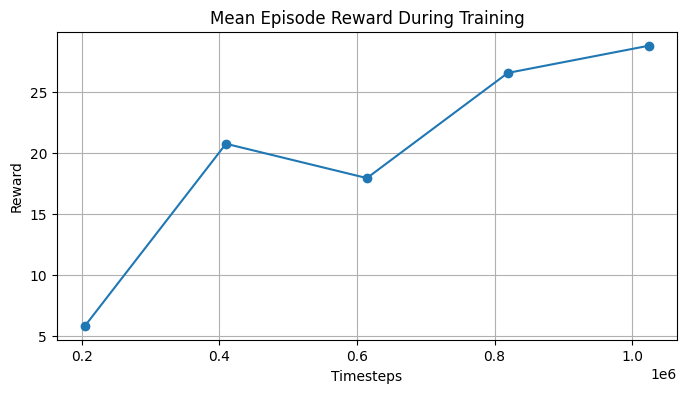

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 100: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step1024000_imageio.mp4
Total reward: 42.69
Reward log: [-0.01, -0.01, -0.01, -0.11, 1.523626708984375, -0.10296157836914062, -0.01, -0.01, -0.11, 1.89, 0.05844161987304688, 0.14054733276367187, 0.16729919433593748, 0.16623809814453125, 0.1915516662597656, 0.2065899658203125, 0.21552413940429688, 0.2208320617675781, 0.22398468017578124, 0.22585739135742186, 0.22697052001953125, 0.22763137817382811, 0.22802413940429686, 5.2282575988769535, 0.22839584350585937, 0.19611495971679688, 0.15734329223632812, 0.11936920166015626, -0.052712402343750006, 1.9286402893066403, -0.08393722534179687, 0.02379608154296875, 0.021108398437500002, 0.019300231933593752, 0.014085693359375, 0.006245269775390626, 0.06283065795898438, 0.13139984130859375, 0.17294586181640625, 0.19762588500976563, 0.21228622436523437, 0.06798385620117188, 2.1672418212890627, 0.13914566040039061, 0.1448

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

##3,072,000

In [ ]:
epnum = n_step * 1500
now = n_step * 500
stepnum = epnum - now
start_time = time.time()

In [ ]:
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel", env=train_env)
model.num_timesteps = now
model.learn(total_timesteps=stepnum, callback=eval_callback, reset_num_timesteps=False)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
|    fps                  | 204         |
|    iterations           | 764         |
|    time_elapsed         | 7635        |
|    total_timesteps      | 2588672     |
| train/                  |             |
|    approx_kl            | 0.033004038 |
|    clip_fraction        | 0.353       |
|    clip_range           | 0.1         |
|    entropy_loss         | -0.909      |
|    explained_variance   | 0.582       |
|    learning_rate        | 0.00025     |
|    loss                 | 1.8         |
|    n_updates            | 5052        |
|    policy_gradient_loss | 0.0151      |
|    value_loss           | 7.53        |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 100        |
|    ep_rew_mean          | 28.6       |
| time/                   |            |
|    fps                  | 204        |
|    iterations           | 765

3072000 Time: 9993.26 秒


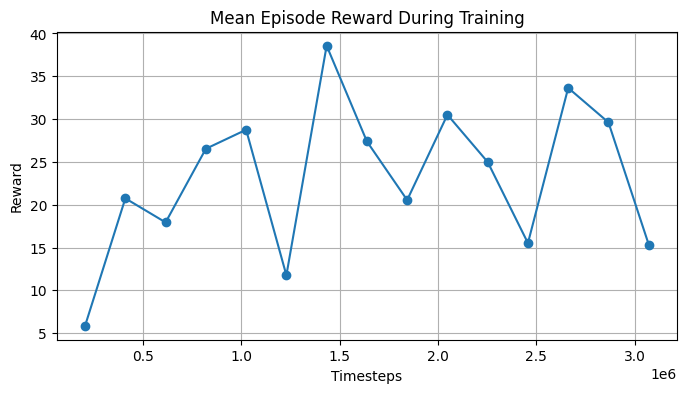

obs[image] shape: (4, 84, 84) min: 1 max: 239
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step3072000_imageio.mp4
Total reward: 11.72
Reward log: [-0.01, -0.01, -0.01, -0.11, 1.5551812744140623, -0.11955245971679687, -0.02496368408203125, -0.01, -0.11, 1.89, 0.05844161987304688, 0.14054733276367187, 0.16729919433593748, 0.16623809814453125, 0.1915516662597656, 0.2065899658203125, 0.21552413940429688, 0.2208320617675781, 0.22398468017578124, 0.22585739135742186, 0.22697052001953125, 0.22763137817382811, 0.22802413940429686, 5.2282575988769535, 0.1960260009765625, 0.15728378295898438, 0.11933288574218752, -0.05272720336914063, 1.9286300659179687, 0.016055603027343747, 0.00757415771484375, -0.0029254150390625004, 0.05231781005859375, 0.02050140380859375, 0.05348922729492187, 0.1255865478515625, 0.11294967651367188, 0.1393971252441406, -0.24379806518554686, 2.059358825683594, 0.1434271240234375, 0.16197845458984375, 0.18118270874023437, 0.20251892089843748, 0.16173141

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

##6,144,000


In [ ]:
epnum = n_step * 3000
now = n_step * 1500
stepnum = epnum - now
start_time = time.time()

In [ ]:
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel", env=train_env)
model.num_timesteps = now
model.learn(total_timesteps=stepnum, callback=eval_callback, reset_num_timesteps=False)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
|    time_elapsed         | 12676       |
|    total_timesteps      | 5660672     |
| train/                  |             |
|    approx_kl            | 0.023908462 |
|    clip_fraction        | 0.243       |
|    clip_range           | 0.1         |
|    entropy_loss         | -0.554      |
|    explained_variance   | 0.636       |
|    learning_rate        | 0.00025     |
|    loss                 | 1.24        |
|    n_updates            | 11052       |
|    policy_gradient_loss | 0.0119      |
|    value_loss           | 8.03        |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 89          |
|    ep_rew_mean          | 36.7        |
| time/                   |             |
|    fps                  | 204         |
|    iterations           | 1265        |
|    time_elapsed         | 12686       |
|    total_timesteps     

6144000 Time: 15027.42 秒


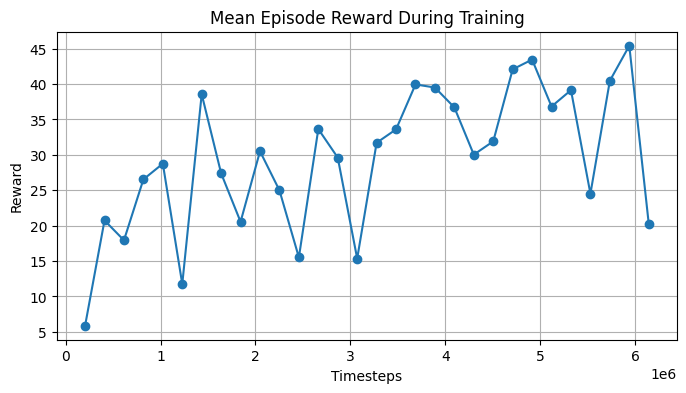

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 93: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step6144000_imageio.mp4
Total reward: 41.54
Reward log: [-0.01, -0.01, -0.01, -0.11, 1.6221450805664062, -0.09764175415039063, -0.05406646728515625, -0.01, -0.11, 1.89, 0.05844161987304688, 0.14054733276367187, 0.179405517578125, 0.15007843017578124, 0.1819525146484375, 0.20088821411132812, 0.21213653564453125, 0.21881881713867188, 0.22278839111328125, 0.22514694213867187, 0.2265484619140625, 0.22738082885742186, 0.22787506103515626, 5.22816879272461, 0.19596923828124999, -0.17948257446289062, 0.00991973876953125, -0.10175613403320312, 2.0126432800292973, 0.0824102783203125, -0.011727447509765626, 0.056285705566406254, 0.03470947265625, 0.02015625, 0.07813766479492189, 0.15284988403320313, 0.1819073486328125, 0.17887649536132813, 0.045498657226562496, 1.9948847961425782, 0.11948471069335938, 0.16284362792968748, 0.18859786987304686, 0.1517213439941406, 0.15521

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

##9,216,000

In [ ]:
epnum = n_step * 4500
now = n_step * 3000
stepnum = epnum - now
start_time = time.time()

In [ ]:
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel", env=train_env)
model.num_timesteps = now
model.learn(total_timesteps=stepnum, callback=eval_callback, reset_num_timesteps=False)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
|    time_elapsed         | 12644       |
|    total_timesteps      | 8732672     |
| train/                  |             |
|    approx_kl            | 0.014269391 |
|    clip_fraction        | 0.214       |
|    clip_range           | 0.1         |
|    entropy_loss         | -0.523      |
|    explained_variance   | 0.653       |
|    learning_rate        | 0.00025     |
|    loss                 | 1.52        |
|    n_updates            | 17052       |
|    policy_gradient_loss | 0.00811     |
|    value_loss           | 7.04        |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 85.9        |
|    ep_rew_mean          | 40.5        |
| time/                   |             |
|    fps                  | 204         |
|    iterations           | 1265        |
|    time_elapsed         | 12654       |
|    total_timesteps     

9216000 Time: 15036.21 秒


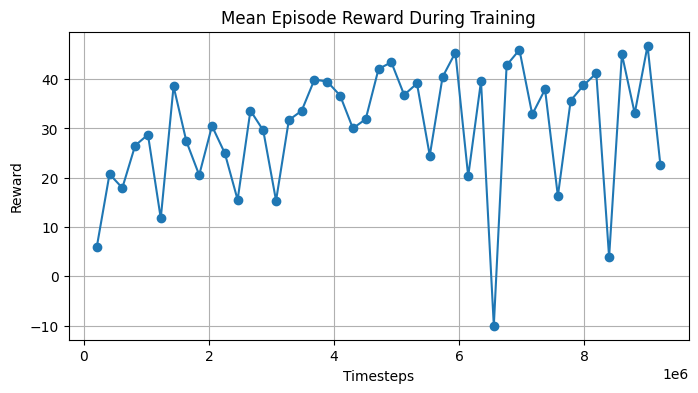

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 109: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step9216000_imageio.mp4
Total reward: 39.34
Reward log: [-0.01, -0.01, -0.7578549194335937, -0.23984512329101565, 1.89, -0.01, -0.01, -0.11, -0.01, -0.11, -0.012264404296875, -0.010001068115234376, -0.11, 1.89, 0.04272705078125, 0.11737457275390627, 0.16517105102539062, 0.19356887817382812, 0.21044158935546875, 0.22046646118164062, 0.22642333984375, 0.22996185302734373, 0.23206405639648436, 0.2333135986328125, 0.23405517578124999, 0.23449600219726563, 5.23475830078125, 0.192962646484375, 0.032353515625, 2.0860182189941407, 0.05476486206054688, 0.03368423461914062, 0.08938949584960938, 0.13541717529296873, -0.05443069458007813, -0.07251876831054688, 0.07930801391601563, -0.017151641845703135, -0.04737304687500001, -0.06775787353515625, -0.08150802612304688, -0.09078277587890625, 1.90296142578125, 0.06396194458007813, -0.02697601318359375, -0.05400024414062501,

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

##12,288,000

In [ ]:
epnum = n_step * 6000
now = n_step * 4500
stepnum = epnum - now
start_time = time.time()

In [ ]:
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel", env=train_env)
model.num_timesteps = now
model.learn(total_timesteps=stepnum, callback=eval_callback, reset_num_timesteps=False)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
|    fps                  | 205         |
|    iterations           | 1264        |
|    time_elapsed         | 12585       |
|    total_timesteps      | 11804672    |
| train/                  |             |
|    approx_kl            | 0.010717481 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.1         |
|    entropy_loss         | -0.557      |
|    explained_variance   | 0.702       |
|    learning_rate        | 0.00025     |
|    loss                 | 3.15        |
|    n_updates            | 23052       |
|    policy_gradient_loss | 0.00185     |
|    value_loss           | 9.84        |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 92.3        |
|    ep_rew_mean          | 41.3        |
| time/                   |             |
|    fps                  | 205         |
|    iterations          

12288000 Time: 14926.75 秒


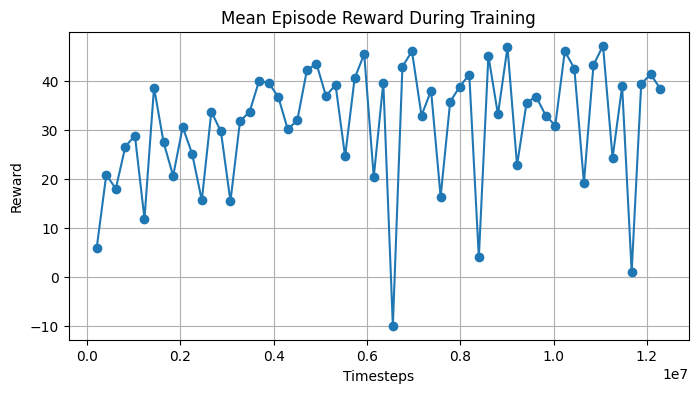

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 84: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step12288000_imageio.mp4
Total reward: 42.63
Reward log: [-0.01, -0.01, -0.01, -0.47, 1.7449377441406249, -0.02405731201171875, -0.01, -0.01, -0.11, 1.89, 0.05844161987304688, 0.11936828613281251, 0.11376083374023438, 0.16037643432617188, 0.18806961059570312, 0.20452133178710938, 0.21429519653320311, 0.22010101318359374, 0.2235504150390625, 0.2255999755859375, 0.22681716918945313, 0.22754013061523437, 0.22796981811523437, 5.228224639892578, 0.1960052490234375, 0.15726974487304687, 0.01175415039062499, 2.063477935791016, 0.045300140380859374, 0.027299957275390627, 0.06481643676757813, 0.13090179443359373, 0.1740357971191406, 0.14394485473632812, 0.0938372802734375, -0.03996078491210938, -0.0627587890625, 0.08640090942382814, 0.15250625610351562, 0.032985534667968754, 1.9864450073242186, 0.055052490234374994, 0.03387786865234375, 0.08429580688476564, 0.146382293

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

##15,360,000

In [ ]:
epnum = n_step * 7500
now = n_step * 6000
stepnum = epnum - now
start_time = time.time()

In [ ]:
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel", env=train_env)
model.num_timesteps = now
model.learn(total_timesteps=stepnum, callback=eval_callback, reset_num_timesteps=False)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
|    time_elapsed         | 12536       |
|    total_timesteps      | 14876672    |
| train/                  |             |
|    approx_kl            | 0.039455682 |
|    clip_fraction        | 0.299       |
|    clip_range           | 0.1         |
|    entropy_loss         | -0.618      |
|    explained_variance   | 0.463       |
|    learning_rate        | 0.00025     |
|    loss                 | 4.41        |
|    n_updates            | 29052       |
|    policy_gradient_loss | 0.0211      |
|    value_loss           | 34.9        |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 93.7        |
|    ep_rew_mean          | 33.3        |
| time/                   |             |
|    fps                  | 206         |
|    iterations           | 1265        |
|    time_elapsed         | 12546       |
|    total_timesteps     

15360000 Time: 14896.78 秒


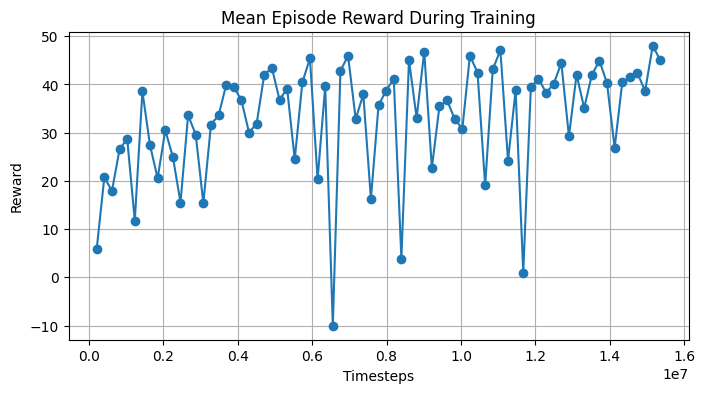

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 80: CLEAR!
Step 81: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step15360000_imageio.mp4
Total reward: 54.07
Reward log: [-0.01, -0.01, -0.01, -0.11, 1.5551812744140623, -0.11955245971679687, -0.02496368408203125, -0.01, -0.11, 2.0584416198730473, 0.14054733276367187, 0.18760543823242187, 0.2002508544921875, 0.2117578125, 0.21859359741210938, 0.22265533447265626, 0.22506774902343749, 0.22650070190429686, 0.22735183715820312, 0.22785797119140624, 0.22815811157226562, 5.228336639404297, 0.19607696533203126, 0.157318115234375, 0.1193536376953125, -0.05271835327148438, 2.0433348083496097, 0.0336181640625, 0.019419708251953126, 0.061449432373046876, 0.12930313110351563, 0.11532760620117187, -0.02546554565429688, 1.9470185852050779, 0.09603103637695314, 0.1625386047363281, 0.20553359985351563, 0.2333294677734375, 0.18768371582031249, 0.1805194091796875, 0.2034779357910156, 0.1627801513671875, 0.1775445556640625, 

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

##18,432,000

In [ ]:
epnum = n_step * 9000
now = n_step * 7500
stepnum = epnum - now
start_time = time.time()

In [ ]:
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel", env=train_env)
model.num_timesteps = now
model.learn(total_timesteps=stepnum, callback=eval_callback, reset_num_timesteps=False)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
|    fps                  | 180        |
|    iterations           | 1264       |
|    time_elapsed         | 14313      |
|    total_timesteps      | 17948672   |
| train/                  |            |
|    approx_kl            | 0.02113916 |
|    clip_fraction        | 0.208      |
|    clip_range           | 0.1        |
|    entropy_loss         | -0.423     |
|    explained_variance   | 0.82       |
|    learning_rate        | 0.00025    |
|    loss                 | 2.58       |
|    n_updates            | 35052      |
|    policy_gradient_loss | 0.0117     |
|    value_loss           | 4.7        |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 85.4        |
|    ep_rew_mean          | 39.9        |
| time/                   |             |
|    fps                  | 180         |
|    iterations           | 1265        |

18432000 Time: 17004.16 秒


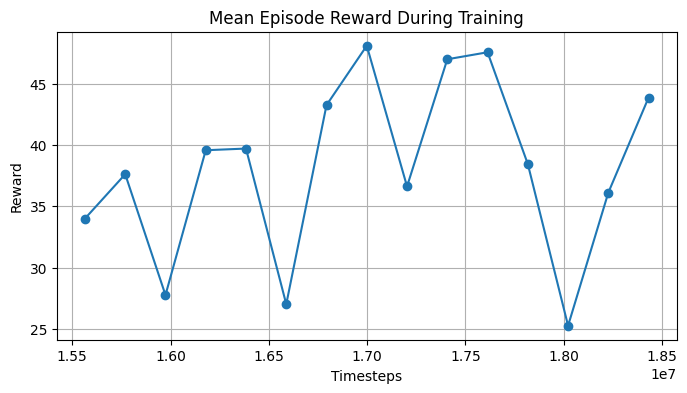

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 108: CLEAR!
Step 109: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step18432000_imageio.mp4
Total reward: 50.69
Reward log: [-0.01, -0.01, -0.01, -0.928033905029297, 1.89, -0.01, -0.01, -0.01, -0.11, 1.89, 0.052227478027343746, 0.123280029296875, 0.16607391357421875, 0.1915046691894531, 0.20661727905273436, 0.2155982971191406, 0.22093475341796875, 0.22410629272460936, 0.22599136352539062, 0.22711090087890626, 0.22777633666992186, 0.22817214965820312, 5.2284080505371096, 0.19614486694335936, 0.15736373901367187, 0.11938201904296876, 0.06064437866210937, -0.055299072265625006, 1.9268955993652341, -0.08511428833007813, 0.006785125732421874, 0.010319061279296876, 0.016832733154296876, 0.08280487060546876, 0.08951538085937501, 0.05712387084960937, -0.064725341796875, 1.9205368041992188, 0.08052047729492189, 0.15770111083984376, 0.11670608520507812, 0.14100662231445313, 0.022348937988281255, -0.020729217529296885,

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

##21,504,000

In [ ]:
epnum = n_step * 10500
now = n_step * 9000
stepnum = epnum - now
start_time = time.time()

In [ ]:
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel", env=train_env)
model.num_timesteps = now
model.learn(total_timesteps=stepnum, callback=eval_callback, reset_num_timesteps=False)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
|    fps                  | 180         |
|    iterations           | 1264        |
|    time_elapsed         | 14359       |
|    total_timesteps      | 21020672    |
| train/                  |             |
|    approx_kl            | 0.017540716 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.1         |
|    entropy_loss         | -0.432      |
|    explained_variance   | 0.872       |
|    learning_rate        | 0.00025     |
|    loss                 | 2.44        |
|    n_updates            | 41052       |
|    policy_gradient_loss | 0.00425     |
|    value_loss           | 3.91        |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 84         |
|    ep_rew_mean          | 41         |
| time/                   |            |
|    fps                  | 180        |
|    iterations           | 126

21504000 Time: 16989.86 秒


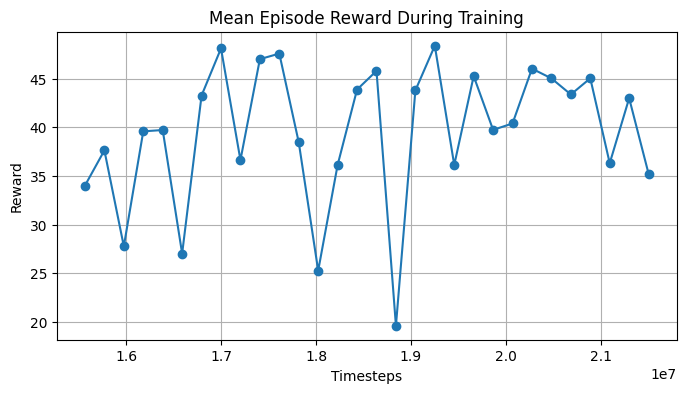

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 91: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step21504000_imageio.mp4
Total reward: 42.23
Reward log: [-0.01, -0.01, -0.01, -0.34698196411132814, 1.8360145568847654, -0.046414794921875, -0.022417449951171876, -0.01, 0.05844161987304688, -0.027894744873046877, 1.9453802490234373, 0.09579605102539063, 0.08921463012695313, 0.1273365783691406, 0.16844161987304687, 0.1928614807128906, 0.2073681640625, 0.21598587036132813, 0.22110595703125, 0.22414779663085938, 0.22595458984375, 0.22702774047851562, 0.22766525268554688, 5.228043212890626, 0.195888671875, 0.15719085693359375, 0.01170074462890624, 1.9550726318359375, -0.06610839843750001, 0.019604034423828125, 0.009967193603515624, 0.05764450073242188, 0.05805923461914062, 0.10329330444335938, 0.0014762878417968698, 1.9651910400390624, 0.10798431396484376, 0.17026641845703125, 0.14587631225585937, 0.15436386108398437, 0.18795806884765626, 0.1960675048828125, 0.1

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

##24,576,000

In [ ]:
epnum = n_step * 12000
now = n_step * 10500
stepnum = epnum - now
start_time = time.time()

In [ ]:
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel", env=train_env)
model.num_timesteps = now
model.learn(total_timesteps=stepnum, callback=eval_callback, reset_num_timesteps=False)
model.save("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel")
check_point(epnum)

Streaming output truncated to the last 5000 lines.
|    fps                  | 211        |
|    iterations           | 1264       |
|    time_elapsed         | 12230      |
|    total_timesteps      | 24092672   |
| train/                  |            |
|    approx_kl            | 0.04096044 |
|    clip_fraction        | 0.217      |
|    clip_range           | 0.1        |
|    entropy_loss         | -0.413     |
|    explained_variance   | 0.69       |
|    learning_rate        | 0.00025    |
|    loss                 | 2.37       |
|    n_updates            | 47052      |
|    policy_gradient_loss | 0.0166     |
|    value_loss           | 7.87       |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 82.3        |
|    ep_rew_mean          | 39          |
| time/                   |             |
|    fps                  | 211         |
|    iterations           | 1265        |

24576000 Time: 14539.01 秒


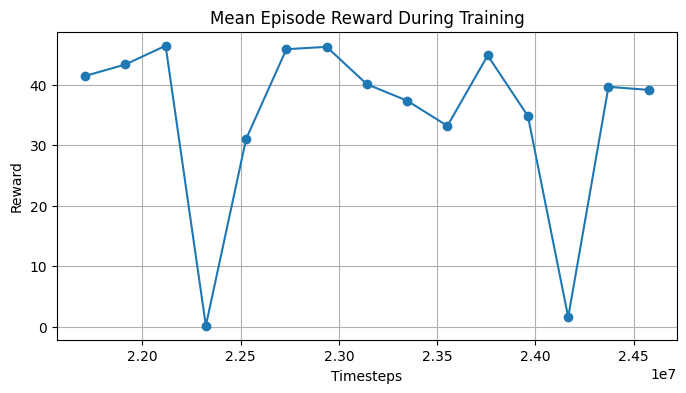

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 86: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step24576000_imageio.mp4
Total reward: 42.66
Reward log: [-0.01, -0.01, -0.37, -0.25506225585937503, 1.7555084228515623, -0.01, -0.01, -0.01, -0.11, 1.89, 0.05844161987304688, 0.14054733276367187, 0.1202153015136719, 0.10883956909179689, 0.15745254516601562, 0.18633285522460938, 0.20348968505859374, 0.21368179321289063, 0.21973709106445313, 0.22333404541015625, 0.22547103881835937, 0.22674026489257812, 0.22749404907226561, 5.227942352294922, 0.195823974609375, 0.15714706420898436, 0.11924789428710937, 0.060597229003906246, -0.05532882690429688, 1.9268756103515623, 0.014872589111328124, 0.006776123046875001, 0.05604812622070312, 0.12673812866210937, 0.17156631469726563, 0.14236495971679686, 0.15874603271484375, 0.038237915039062494, 1.9899874877929686, 0.12429428100585939, 0.11539855957031252, 0.13529708862304687, 0.17664474487304688, 0.2011787414550781, 0.1613

In [ ]:
end_time = time.time()
print(epnum,f"Time: {end_time - start_time:.2f} 秒")
model = PPO.load("/content/drive/MyDrive/ViZDoom_Gymnasium5/Mymodel.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{epnum}.mp4"
plot_eval_rewards("/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations.npz")
run_demo_and_save_video(model, video_path)

#レビュー用

##15,360,000

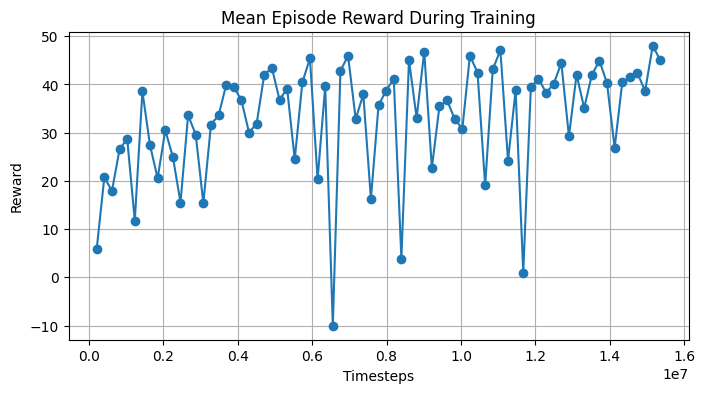

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 90: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step15360000_imageio.mp4
Total reward: 42.37
Reward log: [-0.01, -0.01, -0.07696380615234374, -0.3719111633300781, 1.7780448913574218, -0.028490295410156248, -0.01, -0.01, -0.11, 1.89, 0.05844161987304688, 0.14054733276367187, 0.19592926025390625, 0.10950164794921875, 0.12708892822265624, 0.16833847045898437, 0.19285125732421873, 0.207418212890625, 0.2160748291015625, 0.22121902465820312, 0.22427551269531248, 0.2260926818847656, 0.22717208862304686, 5.227813110351563, 0.19576416015625, 0.15710662841796874, 0.119222412109375, 0.06058670043945313, -0.05533584594726563, 1.9268710327148437, 0.014868927001953124, 0.006773223876953125, 0.05604721069335938, 0.12673812866210937, 0.11368682861328126, 0.1398822021484375, 0.02573165893554686, 1.981552276611328, 0.051752471923828126, 0.09547821044921875, 0.15301864624023437, 0.18715972900390623, 0.20741806030273438, 0.219

In [ ]:
#checkpoint用
checkpointnum=15360000
model = PPO.load(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/Mymodel_{checkpointnum}.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{checkpointnum}.mp4"
plot_eval_rewards(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations_{checkpointnum}.npz")
run_demo_and_save_video(model, video_path)

In [ ]:
print(checkpointnum)
model = PPO.load(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/Mymodel_{checkpointnum}.zip")
env = DoomCorridorHybridEnv(cfg_path=cfg_path, wad_path=wad_path)
rewards = []
cases = 100
clears=0
for i in range(cases):
    obs, _ = env.reset()
    done = False
    total_reward = 0.0

    while not done:
        action, _ = model.predict({k: v[None] for k, v in obs.items()}, deterministic=True)
        obs, reward, done, _, info = env.step(action)
        total_reward += reward
    rewards.append(total_reward)
    if info.get("clear", 0) > 1:
        print(f"[Episode {i+1}] Total Reward: {total_reward:.2f},Scenario Clear!")
        clears += 1
    else:
        print(f"[Episode {i+1}] Total Reward: {total_reward:.2f}")

rewards = np.array(rewards)
print(f"平均: {rewards.mean():.2f}")
print(f"偏差: {rewards.std():.2f}")
print(f"最小: {rewards.min():.2f}")
print(f"最大: {rewards.max():.2f}")
print(f"クリア率: {(clears/cases)*100:.2f}%")

15360000
[Episode 1] Total Reward: 54.44,Scenario Clear!
[Episode 2] Total Reward: 42.16,Scenario Clear!
[Episode 3] Total Reward: 43.45,Scenario Clear!
[Episode 4] Total Reward: 42.09,Scenario Clear!
[Episode 5] Total Reward: 42.05,Scenario Clear!
[Episode 6] Total Reward: 42.08,Scenario Clear!
[Episode 7] Total Reward: 54.24,Scenario Clear!
[Episode 8] Total Reward: 42.48,Scenario Clear!
[Episode 9] Total Reward: 43.68,Scenario Clear!
[Episode 10] Total Reward: 42.62,Scenario Clear!
[Episode 11] Total Reward: 42.94,Scenario Clear!
[Episode 12] Total Reward: 53.55,Scenario Clear!
[Episode 13] Total Reward: 43.32,Scenario Clear!
[Episode 14] Total Reward: 43.05,Scenario Clear!
[Episode 15] Total Reward: 42.67,Scenario Clear!
[Episode 16] Total Reward: 42.48,Scenario Clear!
[Episode 17] Total Reward: 43.55,Scenario Clear!
[Episode 18] Total Reward: 43.80,Scenario Clear!
[Episode 19] Total Reward: 42.59,Scenario Clear!
[Episode 20] Total Reward: 43.05,Scenario Clear!
[Episode 21] Total R

##21,504,000

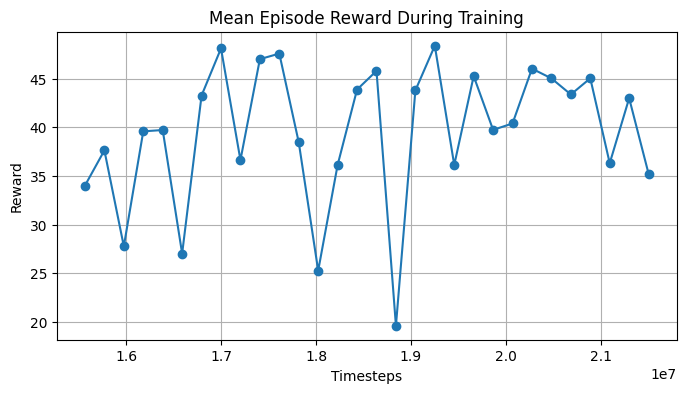

obs[image] shape: (4, 84, 84) min: 5 max: 239
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step21504000_imageio.mp4
Total reward: -8.40
Reward log: [-0.01, -0.01, -0.5961968994140625, -0.16250747680664063, 1.89, -0.11, -0.01, -0.11, -0.01, -0.13, -0.010843505859375, 0.060828552246093744, 0.14579818725585936, 0.20311157226562498, 0.24177032470703125, 0.2678462219238281, 0.21460617065429688, -0.30174102783203127, 0.09591918945312501, 0.06867904663085939, 0.07065017700195313, 0.04439910888671875, 0.018384552001953124, -0.0035247802734375, -10.25784896850586]


In [ ]:
#checkpoint用
checkpointnum=21504000
model = PPO.load(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/Mymodel_{checkpointnum}.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{checkpointnum}.mp4"
plot_eval_rewards(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations_{checkpointnum}.npz")
run_demo_and_save_video(model, video_path)

In [ ]:
print(checkpointnum)
model = PPO.load(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/Mymodel_{checkpointnum}.zip")
env = DoomCorridorHybridEnv(cfg_path=cfg_path, wad_path=wad_path)
rewards = []
cases = 100
clears=0
for i in range(cases):
    obs, _ = env.reset()
    done = False
    total_reward = 0.0

    while not done:
        action, _ = model.predict({k: v[None] for k, v in obs.items()}, deterministic=True)
        obs, reward, done, _, info = env.step(action)
        total_reward += reward
    rewards.append(total_reward)
    if info.get("clear", 0) > 1:
        print(f"[Episode {i+1}] Total Reward: {total_reward:.2f},Scenario Clear!")
        clears += 1
    else:
        print(f"[Episode {i+1}] Total Reward: {total_reward:.2f}")

rewards = np.array(rewards)
print(f"平均: {rewards.mean():.2f}")
print(f"偏差: {rewards.std():.2f}")
print(f"最小: {rewards.min():.2f}")
print(f"最大: {rewards.max():.2f}")
print(f"クリア率: {(clears/cases)*100:.2f}%")

21504000
[Episode 1] Total Reward: 41.82,Scenario Clear!
[Episode 2] Total Reward: 54.42,Scenario Clear!
[Episode 3] Total Reward: 53.18,Scenario Clear!
[Episode 4] Total Reward: 43.20,Scenario Clear!
[Episode 5] Total Reward: 52.57,Scenario Clear!
[Episode 6] Total Reward: 53.36,Scenario Clear!
[Episode 7] Total Reward: 53.12,Scenario Clear!
[Episode 8] Total Reward: 52.73,Scenario Clear!
[Episode 9] Total Reward: 42.85,Scenario Clear!
[Episode 10] Total Reward: 43.30,Scenario Clear!
[Episode 11] Total Reward: 42.97,Scenario Clear!
[Episode 12] Total Reward: 53.71,Scenario Clear!
[Episode 13] Total Reward: 42.59,Scenario Clear!
[Episode 14] Total Reward: 52.49,Scenario Clear!
[Episode 15] Total Reward: 43.45,Scenario Clear!
[Episode 16] Total Reward: 43.20,Scenario Clear!
[Episode 17] Total Reward: 43.21,Scenario Clear!
[Episode 18] Total Reward: 42.71,Scenario Clear!
[Episode 19] Total Reward: 43.09,Scenario Clear!
[Episode 20] Total Reward: 4.62
[Episode 21] Total Reward: 43.02,Scen

##15,155,200　☆BEST
約20時間ところの結果

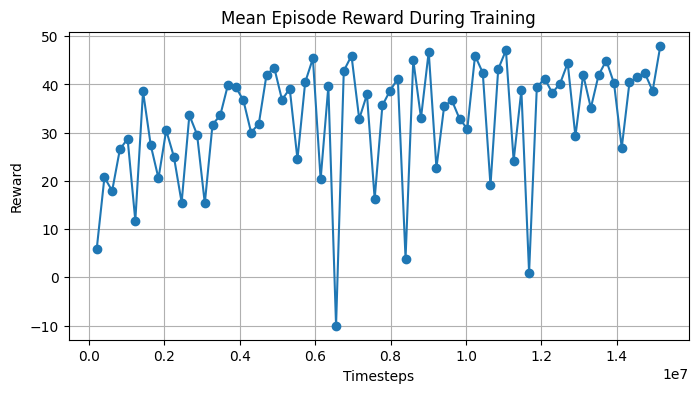

obs[image] shape: (4, 84, 84) min: 1 max: 239
Step 106: CLEAR!
imageio mp4 saved: /content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step15155200_imageio.mp4
Total reward: 41.94
Reward log: [-0.01, -0.01, -0.22982406616210938, -0.2366276550292969, 1.836869659423828, -0.01, -0.01, -0.01, -0.11, 1.89, 0.05844161987304688, 0.14054733276367187, 0.19419265747070313, 0.14603271484375, 0.17456405639648437, 0.19649856567382812, 0.2095294189453125, 0.2172698974609375, 0.22186813354492188, 0.22459945678710938, 0.2262225341796875, 0.22718719482421876, 0.22775985717773437, 5.228100738525391, 0.19592620849609374, 0.15721633911132812, 0.011718292236328124, 2.1235244750976565, 0.11600509643554689, 0.07499176025390626, 0.11832626342773438, 0.18483963012695312, 0.15870574951171876, 0.0037937927246093715, 1.9667547607421876, 0.11169601440429688, 0.10880508422851563, 0.14113372802734375, 0.10925430297851563, 0.09528839111328126, 0.15290573120117187, 0.13042755126953123, 0.15572235107421875, 0.210070343017578

In [ ]:
#checkpoint用
checkpointnum=15155200
model = PPO.load(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/Mymodel_{checkpointnum}.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{checkpointnum}.mp4"
plot_eval_rewards(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations_{checkpointnum}.npz")
run_demo_and_save_video(model, video_path)

In [ ]:
print(checkpointnum)
model = PPO.load(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/Mymodel_{checkpointnum}.zip")
env = DoomCorridorHybridEnv(cfg_path=cfg_path, wad_path=wad_path)
rewards = []
cases = 100
clears=0
for i in range(cases):
    obs, _ = env.reset()
    done = False
    total_reward = 0.0

    while not done:
        action, _ = model.predict({k: v[None] for k, v in obs.items()}, deterministic=True)
        obs, reward, done, _, info = env.step(action)
        total_reward += reward
    rewards.append(total_reward)
    if info.get("clear", 0) > 1:
        print(f"[Episode {i+1}] Total Reward: {total_reward:.2f},Scenario Clear!")
        clears += 1
    else:
        print(f"[Episode {i+1}] Total Reward: {total_reward:.2f}")

rewards = np.array(rewards)
print(f"平均: {rewards.mean():.2f}")
print(f"偏差: {rewards.std():.2f}")
print(f"最小: {rewards.min():.2f}")
print(f"最大: {rewards.max():.2f}")
print(f"クリア率: {(clears/cases)*100:.2f}%")

15155200
[Episode 1] Total Reward: 54.79,Scenario Clear!
[Episode 2] Total Reward: 43.50,Scenario Clear!
[Episode 3] Total Reward: 40.93,Scenario Clear!
[Episode 4] Total Reward: 51.99,Scenario Clear!
[Episode 5] Total Reward: 54.42,Scenario Clear!
[Episode 6] Total Reward: 42.92,Scenario Clear!
[Episode 7] Total Reward: 41.88,Scenario Clear!
[Episode 8] Total Reward: 43.28,Scenario Clear!
[Episode 9] Total Reward: 53.05,Scenario Clear!
[Episode 10] Total Reward: 42.24,Scenario Clear!
[Episode 11] Total Reward: 43.28,Scenario Clear!
[Episode 12] Total Reward: 42.91,Scenario Clear!
[Episode 13] Total Reward: 41.71,Scenario Clear!
[Episode 14] Total Reward: 42.72,Scenario Clear!
[Episode 15] Total Reward: 43.17,Scenario Clear!
[Episode 16] Total Reward: 43.05,Scenario Clear!
[Episode 17] Total Reward: 52.92,Scenario Clear!
[Episode 18] Total Reward: 41.78,Scenario Clear!
[Episode 19] Total Reward: 52.80,Scenario Clear!
[Episode 20] Total Reward: 42.30,Scenario Clear!
[Episode 21] Total R

#test

In [12]:
#checkpoint用
checkpointnum=24576000
model = PPO.load(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/Mymodel_{checkpointnum}.zip")
video_path = f"/content/drive/MyDrive/ViZDoom_Gymnasium5/demo_step{checkpointnum}+86.mp4"
plot_eval_rewards(f"/content/drive/MyDrive/ViZDoom_Gymnasium5/logs/evaluations_{checkpointnum}.npz")
run_demo_and_save_video(model, video_path)

Output hidden; open in https://colab.research.google.com to view.